# SKTIME

In [95]:
import pandas as pd
import numpy as np
import glob  
import plotly.graph_objs as go
import plotly.offline as py
import matplotlib.pyplot as plt               # Visualização de dados
import matplotlib
plt.style.use('fivethirtyeight') 
#import squarify
from datetime import datetime
from folium import Map
from folium.plugins import HeatMap

In [99]:
df = pd.read_csv('all_data.csv')

In [102]:
df.drop(df[df['datacorreta']<'2010-01-01'].index, inplace=True)

In [103]:
df.drop(df[df['datacorreta'].isnull()].index, inplace=True)

In [104]:
df

,ANO_BO,NUM_BO,DATAOCORRENCIA,PERIDOOCORRENCIA,LOGRADOURO,BAIRRO,CIDADE,LATITUDE,LONGITUDE,DESCRICAOLOCAL,DELEGACIA_NOME,DESCR_TIPO_VEICULO,QUANT_CELULAR,datacorreta
0,2011.0,2222.0,01/06/2011,De Madrugada,R Antonio Gandini,Conj.Jose Bonifacio,S.Paulo,-23.541350,-46.445806,Via pública,103º D.P. COHABII/ITAQU.,NaN,NaN,2011-06-01
1,2011.0,2282.0,31/05/2011,A Noite,Rua Da Consolacao,Centro,S.Paulo,-23.548345,-46.647177,Via pública,DEL.POL.MAIRIPORÃ,NaN,1.0,2011-05-31
2,2011.0,4331.0,31/05/2011,A Noite,R Benedito Bernardes,Vila Ema,S.Paulo,-23.580824,-46.543110,Via pública,56º D.P. VILA ALPINA,NaN,NaN,2011-05-31
3,2011.0,2014.0,31/05/2011,De Madrugada,R Kumaki Aoki,Jd Helena,S.Paulo,-23.480922,-46.429622,Via pública,59º D.P. JARDIM DOS IPES,NaN,2.0,2011-05-31
4,2011.0,2288.0,31/05/2011,A Noite,Av Padre Arlindo Vieira,Jardim Climax,S.Paulo,-23.622221,-46.601846,Via pública,26º D.P. SACOMA,NaN,1.0,2011-05-31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1066743,2015.0,542079.0,30/04/2015,Pela Manhã,Rua Conselheiro Ramalho,Bela Vista,S.Paulo,NaN,NaN,Outros,DELEGACIA ELETRONICA,NaN,1.0,2015-04-30
1066744,2015.0,541976.0,30/04/2015,A Noite,Rua Afonso Aliperti,Agua Funda,S.Paulo,-23.634803,-46.620515,Outros,DELEGACIA ELETRONICA,Automovel,1.0,2015-04-30
1066745,2015.0,542132.0,30/04/2015,A Noite,Avenida Vila Ema,Vila Prudente,S.Paulo,-23.577624,-46.575901,Outros,DELEGACIA ELETRONICA,NaN,1.0,2015-04-30
1066746,2015.0,542117.0,30/04/2015,A Noite,Rua Agostinho Da Silva Monteiro,Vila Curuça,S.Paulo,-23.495224,-46.411215,Outros,DELEGACIA ELETRONICA,NaN,1.0,2015-04-30


In [88]:
# #df[df['DATAOCORRENCIA'] > '2020-01-01']
# df = df[df['DATAOCORRENCIA'].notnull()]
# df.drop(df[df['DATAOCORRENCIA']<'2010-01-01'].index, inplace=True)
# df = df.sort_values(by=['DATAOCORRENCIA'])
# #df

In [105]:
df['datetime'] = pd.to_datetime(df['datacorreta'], format='%Y-%m-%d')

In [106]:
df['mes_ano'] = pd.to_datetime(df['datetime'], format='%Y-%m').dt.to_period('M')

In [107]:
ocorrencias = df.groupby('mes_ano').count()['ANO_BO'].reset_index()

In [108]:
ocorrencias = ocorrencias.sort_values(by=['mes_ano'])
ocorrencias

,mes_ano,ANO_BO
0,2010-01,5705
1,2010-02,5427
2,2010-03,6158
3,2010-04,6011
4,2010-05,6284
...,...,...
123,2020-04,6278
124,2020-05,6461
125,2020-06,6364
126,2020-07,6251


In [94]:
df

,ANO_BO,NUM_BO,DATAOCORRENCIA,PERIDOOCORRENCIA,LOGRADOURO,BAIRRO,CIDADE,LATITUDE,LONGITUDE,DESCRICAOLOCAL,DELEGACIA_NOME,DESCR_TIPO_VEICULO,QUANT_CELULAR,datacorreta,datetime,mes_ano
531327,2010.0,834.0,21/01/2010,De Madrugada,Av Inajar De Souza,Vila Nova Cahoeirinha,S.Paulo,NaN,NaN,Via pública,DEL.SEC.S.J RIO PRETO PLANTÃO,NaN,1.0,2010-01-21,2010-01-21,2010-01
530913,2010.0,366.0,21/01/2010,A Noite,Av Sao Miguel,Vl. Marieta,S.Paulo,NaN,NaN,Via pública,24º D.P. PONTE RASA,NaN,NaN,2010-01-21,2010-01-21,2010-01
530912,2010.0,498.0,21/01/2010,De Madrugada,Av Carlos Lacerda,Campo Limpo,S.Paulo,NaN,NaN,Via pública,47º D.P. CAPAO REDONDO,NaN,2.0,2010-01-21,2010-01-21,2010-01
530911,2010.0,141.0,21/01/2010,A Noite,R Manuel Inacio,Jd.Rosina,S.Paulo,NaN,NaN,Via pública,67º D.P. JARDIM ROBRU,NaN,NaN,2010-01-21,2010-01-21,2010-01
530910,2010.0,280.0,21/01/2010,A Noite,R Francisco Marques,Pq. São Rafael,S.Paulo,NaN,NaN,Via pública,55º D.P. PARQUE S.RAFAEL,Automovel,3.0,2010-01-21,2010-01-21,2010-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117728,2020.0,68.0,31/12/2019,A Noite,Rua Luar Do Sertao,Capao Redondo,S.Paulo,-23.686641,-46.792845,Via pública,47º D.P. CAPAO REDONDO,NaN,1.0,2019-12-31,2019-12-31,2019-12
117720,2020.0,5250.0,31/12/2019,De Madrugada,Rua Joaquim Nabuco,Brooklin,S.Paulo,-23.624697,-46.682664,Estacionamento público,DELEGACIA ELETRONICA,NaN,NaN,2019-12-31,2019-12-31,2019-12
117719,2020.0,5239.0,31/12/2019,A Noite,Avenida Auro Soares De Moura Andrade,Barra Funda,S.Paulo,NaN,NaN,Terminal/Estação,DELEGACIA ELETRONICA,NaN,NaN,2019-12-31,2019-12-31,2019-12
117539,2020.0,14.0,31/12/2019,A Tarde,Avenida De Pinedo,Socorro,S.Paulo,-23.667905,-46.713339,Via pública,100º D.P. JDIM HERCULANO,NaN,1.0,2019-12-31,2019-12-31,2019-12


In [ ]:
ocorrencias.index = pd.DatetimeIndex(ocorrencias.mes_ano)

In [ ]:
ocorrencias.drop(columns='mes_ano', inplace=True)

In [78]:
variavel_ano_ = df['ANO_BO'].value_counts()

In [20]:
ocorrencias

<PeriodArray>
['2011-06', '2011-05', '2011-02', '2011-01', '2011-04', '2010-11', '2011-03',
 '2010-06', '2010-12', '2015-12',
 ...
 '2014-10', '2014-11', '2014-09', '2014-08', '2013-04', '2013-03', '2015-05',
 '2011-10', '2010-05', '2016-03']
Length: 128, dtype: period[M]

In [ ]:
df['QUANT_CELULAR'].fillna(value=0, inplace=True)

In [ ]:
df.reset_index(drop=True, inplace=True)

In [ ]:
df = df[df['QUANT_CELULAR']< 500]

## Import Sktime

In [39]:
import warnings
warnings.simplefilter("ignore")
from sktime.datasets import load_airline
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.utils.plotting.forecasting import plot_ys

(<Figure size 1152x288 with 1 Axes>, <AxesSubplot:>)

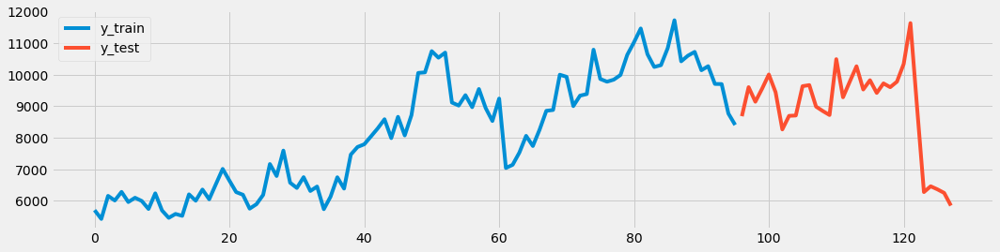

In [64]:
y = ocorrencias['ANO_BO']
#y = load_airline()
y_train, y_test = temporal_train_test_split(y)
fh = np.arange(len(y_test)) + 1
#fh = ForecastingHorizon(ocorrencias.index, is_relative=False)
plot_ys(y_train, y_test, labels=["y_train", "y_test"])

## Naive Forecast com estratégia Last
Se baseia nos últimos dados de treino para criar a predição

In [66]:
from sktime.forecasting.naive import NaiveForecaster
from sktime.performance_metrics.forecasting import smape_loss

# Naive Forecaster com estratégia ''last''
naive_forecaster_last = NaiveForecaster(strategy="last")
naive_forecaster_last.fit(y_train)


NaiveForecaster()

## Naive Forecaster com estratégia last
Essa estratégia se baseia nos ultimos dados e faz um season period de meses igual a 12

SMAPE para estratégia last:  0.14814783659149372
SMAPE para estratégia last com season period 12:  0.16932629822452483


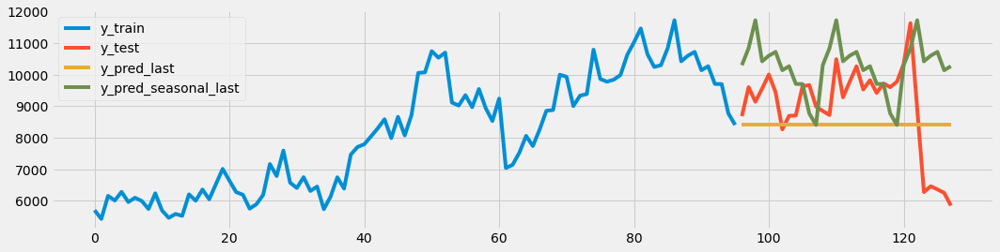

In [67]:
y_last = naive_forecaster_last.predict(fh)
# Naive Forecaster com estratégia ''seasonal_last'' e sp = 12
naive_forecaster_seasonal_last = NaiveForecaster(strategy="last", sp = 12)
naive_forecaster_seasonal_last.fit(y_train)
y_seasonal_last = naive_forecaster_seasonal_last.predict(fh)

plot_ys(y_train, y_test, y_last,y_seasonal_last, labels=["y_train", "y_test", "y_pred_last","y_pred_seasonal_last"]);
print('SMAPE para estratégia ''last'': ', smape_loss(y_last, y_test))
print('SMAPE para estratégia ''last'' com season period 12: ', smape_loss(y_seasonal_last, y_test))

## NaiveForecaster com estratégia média


SMAPE para estratégia média:  0.17496795185801411


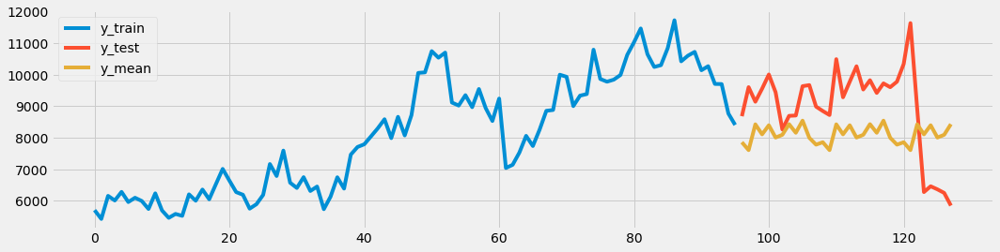

In [69]:
from sktime.forecasting.naive import NaiveForecaster
from sktime.performance_metrics.forecasting import smape_loss

naive_ = NaiveForecaster(strategy="mean", sp = 12)
naive_.fit(y_train)
y_mean = naive_.predict(fh)

plot_ys(y_train, y_test, y_mean, labels=["y_train", "y_test", "y_mean"]);
print('SMAPE para estratégia ''média'': ', smape_loss(y_mean, y_test))

## Naive Forecaster com estratégia drift


SMAPE para estratégia seasonal_last:  0.1280234616997623


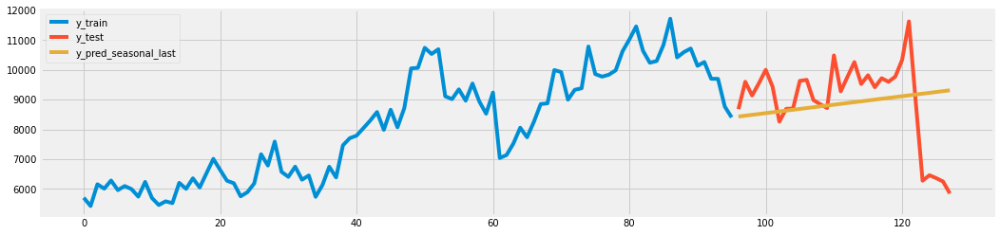

In [77]:
from sktime.forecasting.naive import NaiveForecaster
from sktime.performance_metrics.forecasting import smape_loss

naive_ = NaiveForecaster(strategy="drift", sp = 12)
naive_.fit(y_train)
y_season = naive_.predict(fh)

plot_ys(y_train, y_test, y_season, labels=["y_train", "y_test", "y_pred_seasonal_last"]);
print('SMAPE para estratégia ''seasonal_last'': ', smape_loss(y_season, y_test))

## ReducedRegression
Com regressor RandomForest

SMAPE para Regressão com RandomForest:  0.15432350867418285


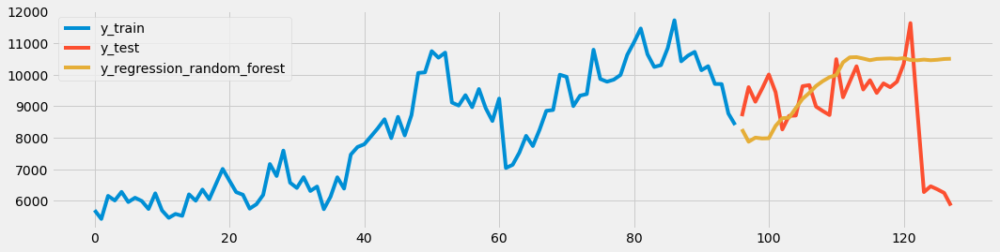

In [72]:
import numpy as np
from sktime.datasets import load_airline
from sktime.forecasting.compose import ReducedRegressionForecaster
from sklearn.ensemble import RandomForestRegressor
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.performance_metrics.forecasting import smape_loss

y_train, y_test = temporal_train_test_split(y)
fh = np.arange(1, len(y_test) + 1)  # forecasting horizon
regressor = RandomForestRegressor()
forecaster = ReducedRegressionForecaster(regressor, window_length=12)
forecaster.fit(y_train)
y_regression_random_forest = forecaster.predict(fh)
plot_ys(y_train, y_test, y_regression_random_forest, labels=["y_train", "y_test", "y_regression_random_forest"]);
print('SMAPE para Regressão com RandomForest: ', smape_loss(y_test, y_regression_random_forest))

## Scikit Learn com KNN Regressor
Usando KNN do Scikit Learn e o modelo ReducedRegressionForecaster

SMAPE para Regressão usando KNN com RandomForest:  0.16846881956128518


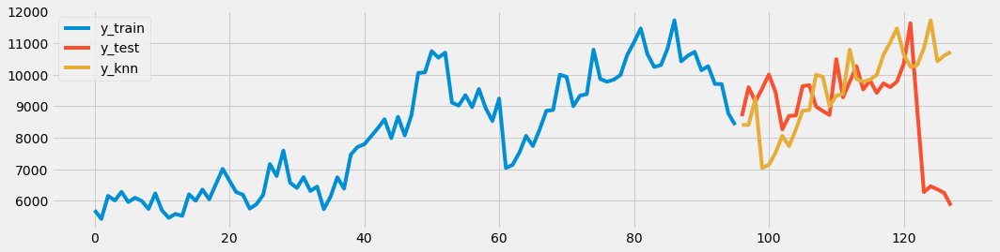

In [73]:
from sklearn.neighbors import KNeighborsRegressor

regressor = KNeighborsRegressor(n_neighbors=1)
forecaster = ReducedRegressionForecaster(regressor=regressor, window_length=12, strategy="recursive")
forecaster.fit(y_train)
y_knn = forecaster.predict(fh)
plot_ys(y_train, y_test, y_knn, labels=["y_train", "y_test", "y_knn"]);
print('SMAPE para Regressão usando KNN com RandomForest: ', smape_loss(y_test, y_knn))

### Acurácia SKlearn

In [65]:
from sklearn.metrics import accuracy_score

#accuracy_score(y_last, y_test)
accuracy_score(y_pred, y_test)

0.0

## ReducedRegressionForecaster

SMAPE usando Floresta Aleatória:  0.12624770850591696


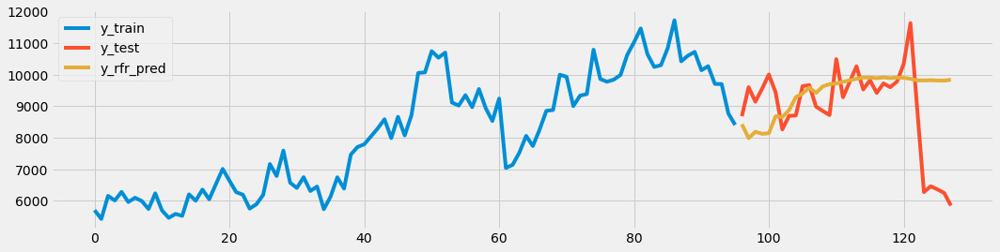

In [77]:
from sktime.forecasting.compose import ReducedRegressionForecaster
from sklearn.ensemble import RandomForestRegressor

rfr = RandomForestRegressor()
rfr_forecaster = ReducedRegressionForecaster(rfr, window_length=12)
rfr_forecaster.fit(y_train)
y_rfr_pred = rfr_forecaster.predict(fh)

plot_ys(y_train, y_test, y_rfr_pred, labels=['y_train', 'y_test', 'y_rfr_pred'])
print('SMAPE usando Floresta Aleatória: ', smape_loss(y_rfr_pred, y_test))

## ExponentialSomoothing

SMAPE usando ExponentialSmoothing:  0.11949604097409822


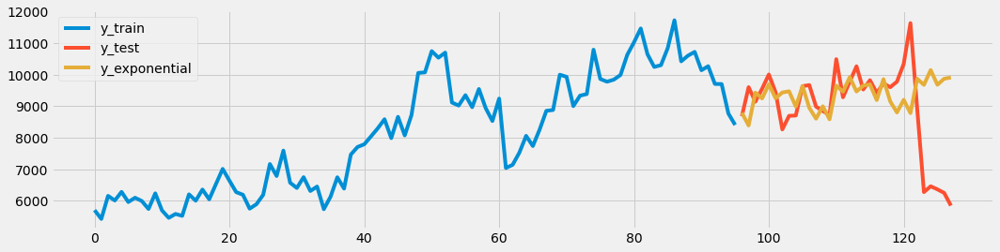

In [75]:
from sktime.forecasting.exp_smoothing import ExponentialSmoothing
forecaster = ExponentialSmoothing(trend="add", seasonal="multiplicative", sp=12)
forecaster.fit(y_train)
y_exponential = forecaster.predict(fh)
plot_ys(y_train, y_test, y_exponential, labels=["y_train", "y_test", "y_exponential"]);
print('SMAPE usando ExponentialSmoothing: ', smape_loss(y_exponential, y_test))

## SlidingWindow e GridSearchCV


SMAPE usando Grid Search:  0.11845397595166852


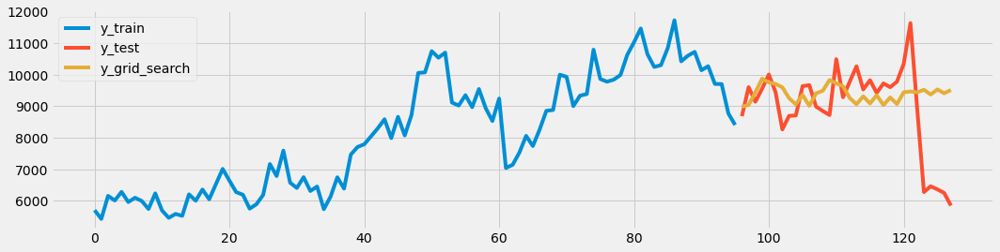

In [83]:
from sktime.forecasting.model_selection import SlidingWindowSplitter
from sktime.forecasting.model_selection import ForecastingGridSearchCV

rfr = RandomForestRegressor()
forecaster = ReducedRegressionForecaster(regressor=rfr, window_length=15, strategy="recursive")
param_grid = {"window_length": [3, 6, 9]}

# we fit the forecaster on the initial window, and then use temporal cross-validation to find the optimal parameter
cv = SlidingWindowSplitter(initial_window=int(len(y_train) * 0.5))
gscv = ForecastingGridSearchCV(forecaster, cv=cv, param_grid=param_grid)
gscv.fit(y_train)
y_grid_search = gscv.predict(fh)
plot_ys(y_train, y_test, y_grid_search, labels=["y_train", "y_test", "y_grid_search"]);
print('SMAPE usando Grid Search: ', smape_loss(y_grid_search, y_test))

# PyMove

In [33]:
dataset = df[df['LONGITUDE'].notnull()]

In [34]:
import pymove
from pymove import MoveDataFrame

In [35]:
move_df = MoveDataFrame(data=dataset, latitude="LATITUDE", longitude="LONGITUDE", datetime="datetime", traj_id="NUM_BO")

In [36]:
move_df.drop(move_df[move_df['datetime']<'2010-01-01'].index, inplace=True)

In [37]:
move_df = move_df.sort_values(by=['datetime'])
move_df

,ANO_BO,id,datetime,PERIDOOCORRENCIA,LOGRADOURO,BAIRRO,CIDADE,lat,lon,DESCRICAOLOCAL,DELEGACIA_NOME,DESCR_TIPO_VEICULO,QUANT_CELULAR,datacorreta,mes_ano
DATAOCORRENCIA,,,,,,,,,,,,,,,
2010-01-01,2011.0,12.0,2010-01-01,Pela Manhã,R Gal Osorio,NaN,S.Paulo,-23.535546,-46.638909,Via pública,03º D.P. CAMPOS ELISEOS,NaN,NaN,2010-01-01,2010-01-01
2010-01-01,2011.0,41.0,2010-01-01,A Noite,Av Prof Celestino Bourrol,Limao,S.Paulo,-23.503951,-46.672253,Via pública,13º D.P. CASA VERDE,Automovel,NaN,2010-01-01,2010-01-01
2010-01-01,2011.0,4.0,2010-01-01,A Noite,R Barra Funda,Barra Funda,S.Paulo,-23.531679,-46.654159,Via pública,23º D.P. PERDIZES,NaN,1.0,2010-01-01,2010-01-01
2010-01-01,2011.0,25.0,2010-01-01,Pela Manhã,Est De Itapecerica,Vila Das Belezas,S.Paulo,-23.642433,-46.739590,Via pública,37º D.P. CAMPO LIMPO,NaN,NaN,2010-01-01,2010-01-01
2010-01-01,2011.0,47.0,2010-01-01,A Noite,R Sete De Abril,Centro,S.Paulo,-23.547417,-46.639867,Via pública,01º D.P. SE,NaN,NaN,2010-01-01,2010-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-08,2020.0,1803.0,2020-12-08,A Noite,Rua Mogeiro,Perus,S.Paulo,-23.407858,-46.758527,Via pública,46º D.P. PERUS,NaN,1.0,2020-12-08,2020-12-08
2020-12-08,2020.0,1782.0,2020-12-08,A Noite,Rua Francisco Alves Bezerra,Vila Medeiros,S.Paulo,-23.484175,-46.567475,Via pública,39º D.P. VILA GUSTAVO,NaN,1.0,2020-12-08,2020-12-08
2020-12-08,2020.0,1140917.0,2020-12-08,A Tarde,Rua Domingos De Morais,Vila Mariana,S.Paulo,-23.590149,-46.635196,Via Pública,DELEGACIA ELETRONICA,NaN,NaN,2020-12-08,2020-12-08


In [ ]:
move_df.index = pd.DatetimeIndex(move_df['datetime'])

In [46]:
move_df['BAIRRO'].value_counts()

Republica                                   17543
Itaquera                                    15829
Grajau                                      15250
Itaim Paulista                              14783
Jabaquara                                   13662
                                            ...  
Cid Nova São Miguel                             1
- ***** Oficio Nº 588 /2014 P/ 15 Dp * -        1
Jardim Dulce                                    1
P. Novo Mundo                                   1
Aecarvalho                                      1
Name: BAIRRO, Length: 17633, dtype: int64

In [ ]:
move_df.reset_index(drop=True, inplace=True)

In [ ]:
df['mes_ano'] = pd.to_datetime(move_df['datetime'], format='%Y-%m')

In [47]:
pymove.visualization.folium.faster_cluster(move_df)

HeatMap apenas para alguns locais (bairros)

In [44]:
pymove.visualization.folium.heatmap(move_df[move_df['BAIRRO']=='Republica'])

In [ ]:
#pymove.visualization.folium.heatmap_with_time(move_df)
#move_df[0:1000]

In [ ]:
#pymove.visualization.folium.add_event_folium(move_data=move_df[0:1000], tiles='CartoDB positron')

In [ ]:
#pymove.visualization.folium.heatmap_with_time(move_data=move_df[0:100])

In [ ]:
#pymove.visualization.matplotlib.show_object_id_by_date(move_data=move_df[0:10000])